In [3]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import skimage.io
import skimage.color
import skimage.filters
from scipy import signal
import random
import colorsys

## Necessary funcs

In [4]:
def magnitude(img):
  row,col,ch = img.shape

  output = np.zeros([row, col])

  for i in range(row):
    for j in range (col):
      val = img[i, j]
      mag = np.sqrt(val.dot(val))
      output[i,j] = mag

  return output.astype(np.uint8)

def calculate_histogram(image):

    histogram = np.histogram(image.ravel(), bins=256, range=(0, 256))[0]

    return histogram

In [5]:
def global_histogram_equalization(image):
  h,w = image.shape
  N = h*w

  histogram = np.zeros(256)

  for i in image:
    histogram[i] += 1

  histogram = histogram/N
  cdf = histogram.cumsum()
  cdf = (255 * cdf / cdf[-1])

  result = cdf[image].astype(np.uint(8))

  return result

In [6]:
def convolution(image,kernel):
    kw,kh=kernel.shape
    iw,ih=image.shape

    padtop,padbottom=(kw//2,kw//2)
    padleft,padright=(kh//2,kh//2)

    imagepadded=np.pad(image,((padtop,padbottom),(padleft,padright)))

    output=np.zeros((iw,ih))

    for i in range(iw):
        for j in range(ih):
            output[i,j]=(np.sum(imagepadded[i:i+kw,j:j+kh]*kernel))
    return output

In [7]:
def difference(rgb_image,hsv_image):

  difference_img = abs(rgb_image - hsv_image)
  #difference_img = cv2.cvtColor(difference_img, cv2.COLOR_RGB2GRAY)
  difference_img = magnitude(difference_img)
  difference_img = 255 * ((difference_img - np.min(difference_img)) / (np.max(difference_img) - np.min(difference_img)))

  return difference_img

In [8]:
def scale(arr):
  min_val = np.min(arr)
  max_val = np.max(arr)

  scaled_array = 255 * (arr - min_val) / (max_val - min_val)

  return scaled_array.astype(np.uint8)

#Task 1: Linear Filter
You are required to implement the Smoothing Operation with Average Filter (Box & Weighted Average filters). Both filters can contain user defined parameters to obtain different levels of blurring effects, which is the size of the filter in this case. Complete the following two functions

In [9]:
def make_box_filter(n):
    return np.ones((n,n))/(n*n)

def make_wavg_filter(n=3,s=1.0):
   filter = np.zeros((n,n))

   u = n//2

   for i in range(n):
      for j in range(n):
         filter[i,j] = (1.0/(2*np.pi*s*s))*np.exp( -( ((i-u)**2+(j-u)**2) / (2*s*s) ) )
   
   return filter

def boxFilter(image, size , hsv=False):
  #implement this function

  temp_image = image.copy()
  if hsv:
     temp_image[:,:,2] = convolution(temp_image[:,:,2],make_box_filter(size))
  else:
    temp_image[:,:,0] = convolution(temp_image[:,:,0],make_box_filter(size))
    temp_image[:,:,1] = convolution(temp_image[:,:,1],make_box_filter(size)) 
    temp_image[:,:,2] = convolution(temp_image[:,:,2],make_box_filter(size))



  return temp_image

def weightedFilter(image, size:float,var = 1 ,hsv=False):
  #implement this function
  temp_image = image.copy()
  if hsv:
   temp_image[:,:,2] = convolution(temp_image[:,:,2],make_wavg_filter(n=size,s=var))
  else:
    temp_image[:,:,0] = convolution(temp_image[:,:,0], make_wavg_filter(n=size,s=var))
    temp_image[:,:,1] = convolution(temp_image[:,:,1], make_wavg_filter(n=size,s=var)) 
    temp_image[:,:,2] = convolution(temp_image[:,:,2] ,make_wavg_filter(n=size,s=var))



  return temp_image


## Image Load


In [10]:
def showImage(image,hsv=False):
    temp_image = image.copy().astype(np.uint8)


    if hsv:
        temp_image = cv2.cvtColor(temp_image, cv2.COLOR_HSV2BGR)
    cv2.imshow('image',temp_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()



In [11]:

def load_image(image_path):
    image2 = cv2.imread(image_path, cv2.IMREAD_COLOR )
    image2 = cv2.resize(image2, (512, 512))
    rgb_img = image2.copy()
    hsv_img = image2.copy()
    
    hsv_image = cv2.cvtColor(hsv_img, cv2.COLOR_BGR2HSV)

    return rgb_img, hsv_image

def display_images(images, titles,max_img_per_row=3,vmin=0,vmax=255,conversion=cv2.COLOR_BGR2RGB):
   
    num_images = len(images)
    max_images_per_row = max_img_per_row
    num_rows = (num_images + max_images_per_row - 1) // max_images_per_row  # Calculate number of rows needed
    
    # Create the subplots
    fig, axs = plt.subplots(num_rows, max_images_per_row, figsize=(15, 5 * num_rows))
    
    # Flatten the axs array in case of multiple rows
    axs = axs.flatten()
    
    for i in range(num_images):
        disp_image = cv2.cvtColor(images[i].astype(np.uint8),conversion)
        axs[i].imshow(disp_image,cmap='grey',vmin=vmin,vmax=vmax)
        axs[i].set_title(titles[i])
        axs[i].axis('off')  # Hide axes
    
    # Turn off remaining subplots if there are any
    for i in range(num_images, len(axs)):
        axs[i].axis('off')
    
    plt.tight_layout()
    plt.show()


# Task 1: Output and Analysis
For this task, use an appropriate color image from Chapter 06.zip. Use your previously implemented functions to show the outputs of the two averaging filters on the sample image in both RGB and HSV color spaces. Provide your analysis on the following topics:
<ol>
<li> Explain how the parameters affect the increase or de crease of the blurring effect.</li>

<li> Do we require intensity scaling after applying averaging filters? </li>

<li> Is there any differences observed between the results of RGB and HSV color spaces? </li>
</ol>

Q. Explain how the parameters affect the increase or de crease of the blurring effect.  
Ans: The parameters responsible:
* kernel size(n): Higher kernel size gives average of a bigger region
* Variance: Only for Weighted Average Kernel. Higher varience gives more weight to further pixels.  

Q. Do we require intensity scaling after applying averaging filters?  
Ans: If the sum of the weights equal 1, then no intensity scaling is needed. Box filter and WA filter both have normalized weights so no scaling is needed.  

Q. Is there any differences observed between the results of RGB and HSV color spaces?
Ans: The averaging runs only on the I channel in HSV. So from the HSV outputs, specially from the box filter it is visible that instead of color averaging, the pixel brightness is being mixed. This effect is less visible in the WA filter.

In [83]:
lenna_rgb , lenna_hsv = load_image('lenna.tif')


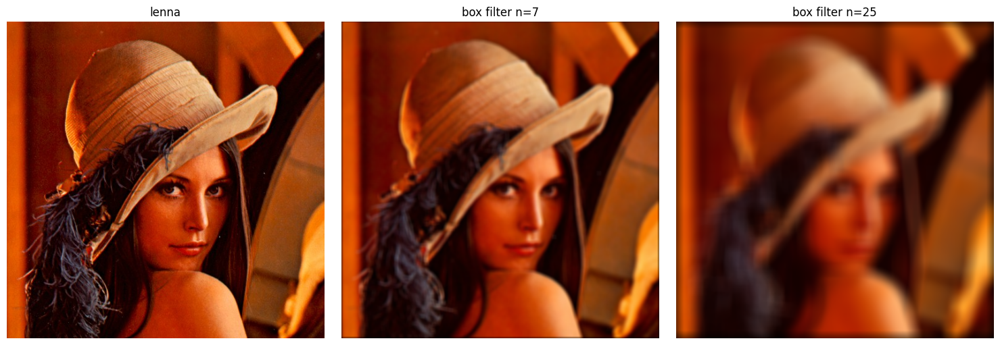

In [84]:
lenna_blur = boxFilter(lenna_rgb, 7, hsv=False) 
lenna_blur2 =boxFilter(lenna_rgb, 25, hsv=False) 
images=[lenna_rgb, lenna_blur,lenna_blur2]
titles=['lenna', 'box filter n=7','box filter n=25']

display_images(images,titles,max_img_per_row=3)


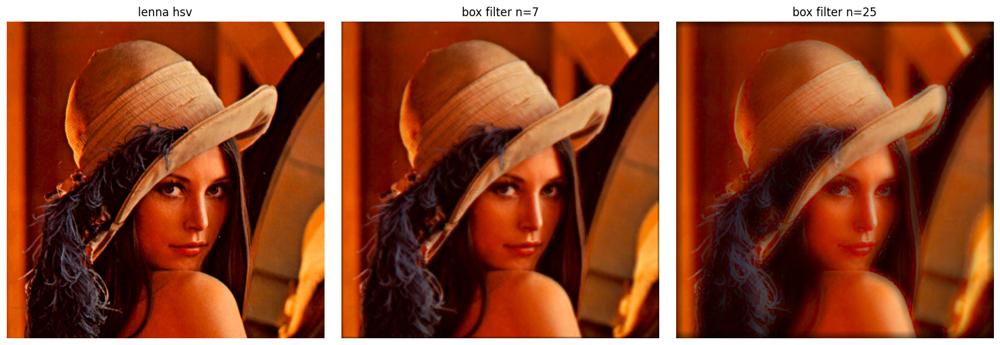

In [85]:
# Generate outputs for Task 1 here
lenna_blur = boxFilter(lenna_hsv, 7,  hsv=True) 
lenna_blur2 =boxFilter(lenna_hsv, 25, hsv=True) 
images=[lenna_hsv, lenna_blur,lenna_blur2]
titles=['lenna hsv', 'box filter on hsv n=7','box filter on hsv n=25']

display_images(images,titles,max_img_per_row=3, conversion=cv2.COLOR_HSV2RGB)


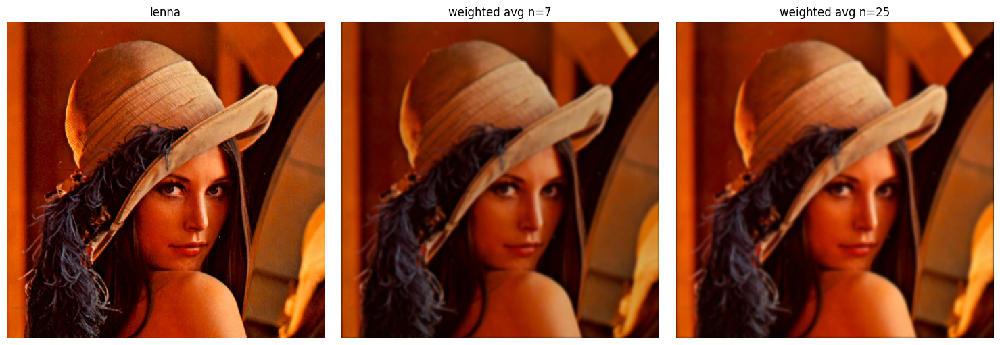

In [86]:
lenna_blur = weightedFilter(lenna_rgb.astype(np.float32),size=7,var=2.0)
lenna_blur2 = weightedFilter(lenna_rgb.astype(np.float32),size=25,var=2.0)
images=[lenna_rgb, lenna_blur,lenna_blur2]
titles=['lenna', 'weighted avg n=7','weighted avg n=25']

display_images(images,titles,max_img_per_row=3)


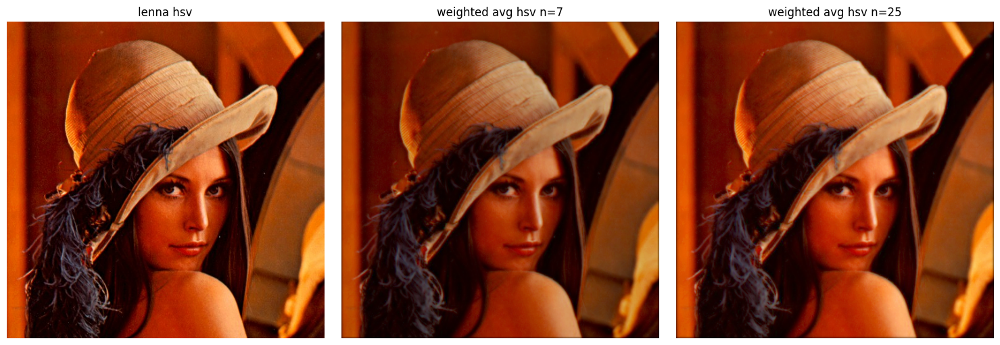

In [87]:
# Generate outputs for Task 1 here
lenna_blur = weightedFilter(lenna_hsv.astype(np.float32),size=7,var=2.0,hsv=True)
lenna_blur2 = weightedFilter(lenna_hsv.astype(np.float32),size=25,var=2.0,hsv=True)
images=[lenna_hsv, lenna_blur,lenna_blur2]
titles=['lenna hsv', 'weighted avg hsv n=7','weighted avg hsv n=25']

display_images(images,titles,max_img_per_row=3,conversion=cv2.COLOR_HSV2RGB)

##Analysis:
[Write your analysis here]

# Task 2
For this task, you are required to write a function designed to artificially add Salt & Pepper noise to a given image. The function should contain a parameter called noise_level (value between 0 and 1) that determines the percentage of pixels that will be affected by Salt & Pepper noise.

Also, write three separate functions to implement the Median Filter, Min Filter, and Max Filter.

In [52]:
def salt_and_pepper(image, noise_level):
  #implement this function
  noisy_image = image.copy()

  for i in range(image.shape[0]):
    for j in range(image.shape[1]): 
      if np.random.random() < noise_level:
        noise = np.random.randint(low=0, high=2)*255
        noisy_image[i, j,0] = noise
        noisy_image[i, j,1] = noise
        noisy_image[i, j,2] = noise


  return noisy_image


In [53]:
def median_single_channel(image,size):
    kw,kh=(size,size)
    iw,ih=image.shape

    padtop,padbottom=(kw//2,kw//2)
    padleft,padright=(kh//2,kh//2)

    imagepadded=np.pad(image,((padtop,padbottom),(padleft,padright)))

    output=np.zeros((iw,ih))

    for i in range(iw):
        for j in range(ih):
            output[i,j]=(np.median(imagepadded[i:i+kw,j:j+kh]))
    return output

def medianFilter(noisy_image, size,hsv=False):
  #implement this function
  corrected_image = noisy_image.copy()

  if hsv:
      
    corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_BGR2HSV)

    corrected_image[:,:,2] = median_single_channel(corrected_image[:,:,2],size)
    # corrected_image[:,:,1] = median_single_channel(corrected_image[:,:,1],size)

    corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_HSV2BGR)

  else:
      corrected_image[:,:,0] = median_single_channel(corrected_image[:,:,0],size)
      corrected_image[:,:,1] = median_single_channel(corrected_image[:,:,1],size)
      corrected_image[:,:,2] = median_single_channel(corrected_image[:,:,2],size)

  return corrected_image

In [54]:
def min_single_channel(image,size):
    kw,kh=(size,size)
    iw,ih=image.shape

    padtop,padbottom=(kw//2,kw//2)
    padleft,padright=(kh//2,kh//2)

    imagepadded=np.pad(image,((padtop,padbottom),(padleft,padright)))

    output=np.zeros((iw,ih))

    for i in range(iw):
        for j in range(ih):
            output[i,j]=(np.min(imagepadded[i:i+kw,j:j+kh]))
    return output

def minFilter(noisy_image, size,hsv=False):
  #implement this function
  corrected_image = noisy_image.copy()

  if hsv:
      
    corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_BGR2HSV)

    corrected_image[:,:,2] = min_single_channel(corrected_image[:,:,2],size)
    # corrected_image[:,:,1] = min_single_channel(corrected_image[:,:,1],size)

    corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_HSV2BGR)

  else:
      corrected_image[:,:,0] = min_single_channel(corrected_image[:,:,0],size)
      corrected_image[:,:,1] = min_single_channel(corrected_image[:,:,1],size)
      corrected_image[:,:,2] = min_single_channel(corrected_image[:,:,2],size)

  return corrected_image

In [55]:
def max_single_channel(image,size):
    kw,kh=(size,size)
    iw,ih=image.shape

    padtop,padbottom=(kw//2,kw//2)
    padleft,padright=(kh//2,kh//2)

    imagepadded=np.pad(image,((padtop,padbottom),(padleft,padright)))

    output=np.zeros((iw,ih))

    for i in range(iw):
        for j in range(ih):
            output[i,j]=(np.max(imagepadded[i:i+kw,j:j+kh]))
    return output

def maxFilter(noisy_image, size,hsv=False):
  #implement this function
  corrected_image = noisy_image.copy()

  if hsv:
      
      corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_BGR2HSV)

      corrected_image[:,:,2] = max_single_channel(corrected_image[:,:,2],size)
    #   corrected_image[:,:,1] = max_single_channel(corrected_image[:,:,1],size)

      corrected_image = cv2.cvtColor(corrected_image,cv2.COLOR_HSV2BGR)

  else:
      corrected_image[:,:,0] = max_single_channel(corrected_image[:,:,0],size)
      corrected_image[:,:,1] = max_single_channel(corrected_image[:,:,1],size)
      corrected_image[:,:,2] = max_single_channel(corrected_image[:,:,2],size)

  return corrected_image

# Task 2: Output and Analysis
Use your previously implemented functions to show the addition of salt & pepper noise to a sample image, as well as how your implemented filters can remove the noise.

Show the results for both RGB and HSV color spaces.

Provide your analysis on the following topic:
<ol>
<li> What happens when the noise level increases for a particular filter size? </li>

<li> How does filter size affect the noise reduction? </li>

<li> Is there any differences observed between the results of RGB and HSV color spaces? </li>
</ol>

### Median filter rgb

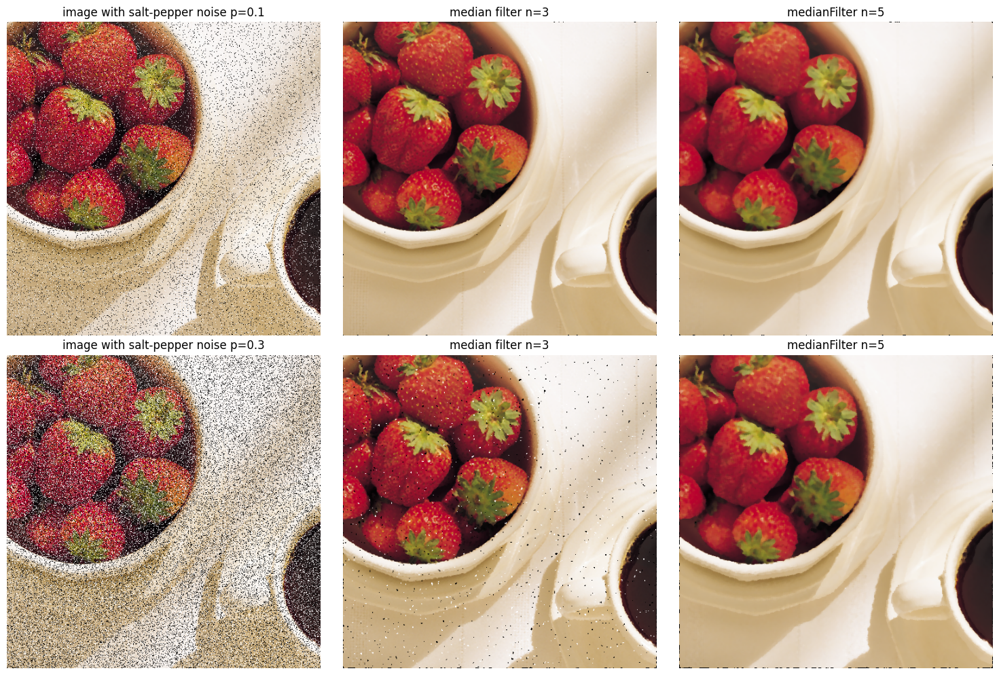

In [56]:
#Generate output for Task 2 here

berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
peppered_berry_more_noise = salt_and_pepper( berry_rgb,.3)

median_filtered_berry = medianFilter(peppered_berry,3)
median_filtered_berry2 = medianFilter(peppered_berry,5)

median_filtered_berry_n = medianFilter( peppered_berry_more_noise,3)
median_filtered_berry2_n = medianFilter(peppered_berry_more_noise,5)

images = [peppered_berry,median_filtered_berry,median_filtered_berry2,
          peppered_berry_more_noise,median_filtered_berry_n,median_filtered_berry2_n,]
titles = ['image with salt-pepper noise p=0.1','median filter n=3','medianFilter n=5',
          'image with salt-pepper noise p=0.3','median filter n=3','medianFilter n=5']

display_images(images, titles)


### Median on hsv

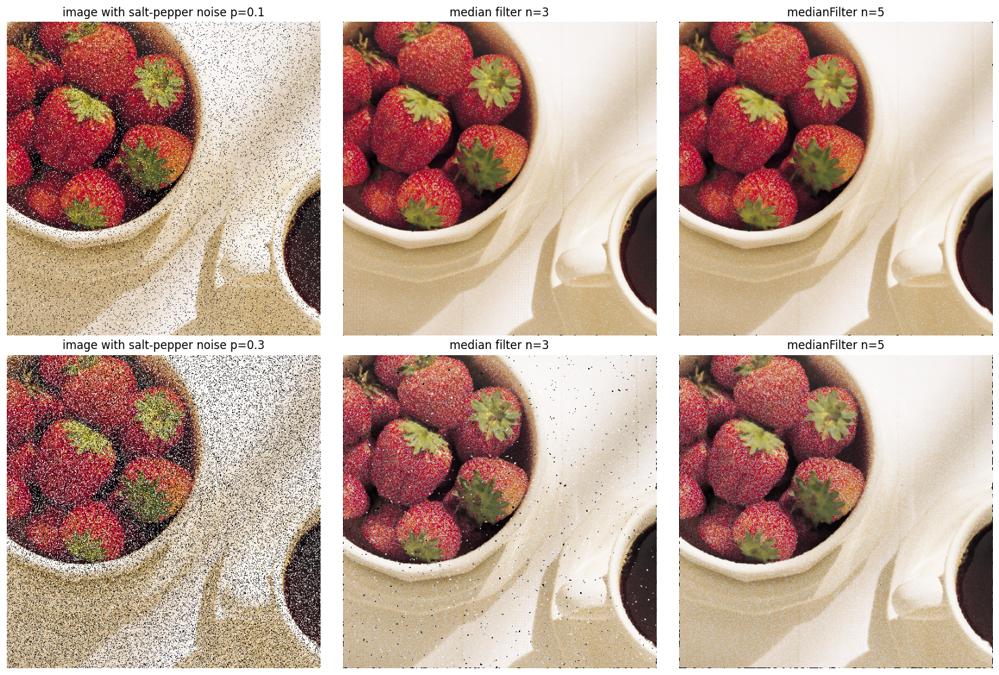

In [57]:
#Generate output for Task 2 here

berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
peppered_berry_more_noise = salt_and_pepper( berry_rgb,.3)

median_filtered_berry = medianFilter(peppered_berry,3 ,hsv=True)
median_filtered_berry2 = medianFilter(peppered_berry,5,hsv=True)

median_filtered_berry_n = medianFilter( peppered_berry_more_noise,3,hsv=True)
median_filtered_berry2_n = medianFilter(peppered_berry_more_noise,5,hsv=True)

images = [peppered_berry,median_filtered_berry,median_filtered_berry2,
          peppered_berry_more_noise,median_filtered_berry_n,median_filtered_berry2_n,]
titles = ['image with salt-pepper noise p=0.1','median filter n=3','medianFilter n=5',
          'image with salt-pepper noise p=0.3','median filter n=3','medianFilter n=5']

display_images(images, titles)

### Max filter on rgb

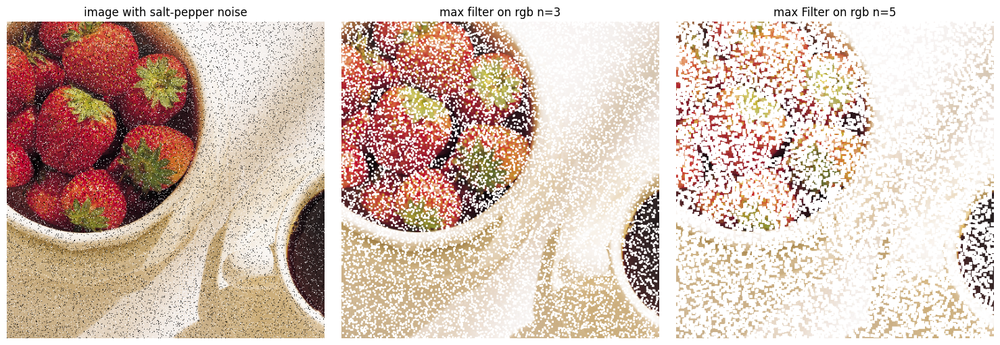

In [78]:
berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
max_filtered_berry =  maxFilter(peppered_berry,3,hsv=False)
max_filtered_berry2 = maxFilter(peppered_berry,5,hsv=False)

images = [peppered_berry,max_filtered_berry,max_filtered_berry2]
titles = ['image with salt-pepper noise','max filter on rgb n=3','max Filter on rgb n=5']

display_images(images, titles)

### Max filter on hsv

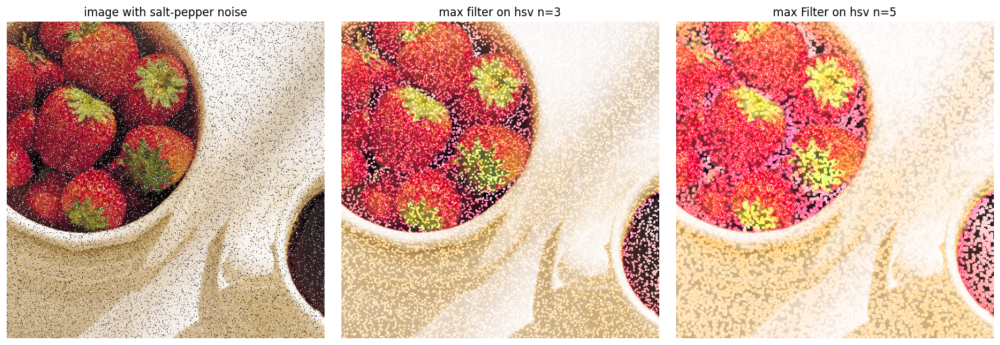

In [79]:
berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
max_filtered_berry =  maxFilter(peppered_berry,3,hsv=True)
max_filtered_berry2 = maxFilter(peppered_berry,5,hsv=True)

images = [peppered_berry,max_filtered_berry,max_filtered_berry2]
titles = ['image with salt-pepper noise','max filter on hsv n=3','max Filter on hsv n=5']

display_images(images, titles)

### Min filter on rgb

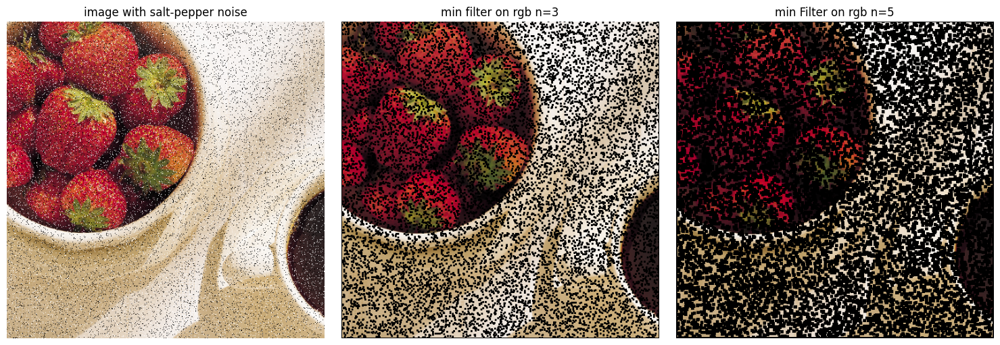

In [81]:
berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
min_filtered_berry =  minFilter(peppered_berry,3,hsv=False)
min_filtered_berry2 = minFilter(peppered_berry,5,hsv=False)

images = [peppered_berry,min_filtered_berry,min_filtered_berry2]
titles = ['image with salt-pepper noise','min filter on rgb n=3','min Filter on rgb n=5']

display_images(images, titles)

### Min filter on hsv

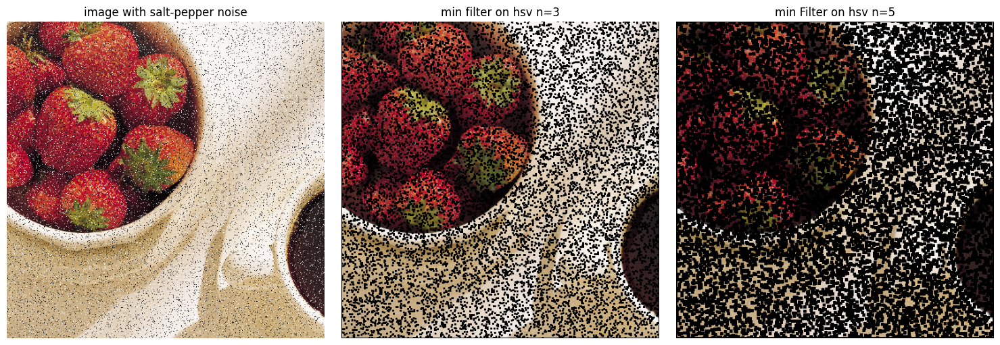

In [82]:
berry_rgb,berry_hsv = load_image('berry.tif')


peppered_berry = salt_and_pepper( berry_rgb,.1)
min_filtered_berry =  minFilter(peppered_berry,3,hsv=True)
min_filtered_berry2 = minFilter(peppered_berry,5,hsv=True)

images = [peppered_berry,min_filtered_berry,min_filtered_berry2]
titles = ['image with salt-pepper noise','min filter on hsv n=3','min Filter on hsv n=5']

display_images(images, titles)

## Analysis:
 Q.What happens when the noise level increases for a particular filter size?
 Ans: For increased noise levels, the median filter of size 3 fails to remove all the noise. The median filter takes the noisy pixel as the median output.  

 How does filter size affect the noise reduction?  
 Ans: The bigger the filter size, the lower the amount of noise in the filter area. Thus it is more likely to pick an actual pixel value. But higher filters are more likely to pick a pixel value which belongs to a region further than the filter currenty is. THis creates a washed out effect.  

 Is there any differences observed between the results of RGB and HSV color spaces?  
 Ans:
 * Median Filter: RGB median filter makes the image washed out. HSV median filter makes the image low contrast.
 * Min Filter: RGB min filter chooses the nearest darkest pixel value. HSI chooses the lowest intensity pixel thus hsi makes some colored pixel dark.
 * Max Filter: RGB max filter chooses the most white pixel. It makes filter region white. HSI max filter chooses the highest intensity pixel regardless of color, so this might boost some color values.


# Task 3

For this task, you are required to design a Laplacian filter that will be used to compute edge responses. The function will return the edge response as an image, which will be called inside the sharpen function to generate a sharpened version of an image. The sharpen function contains a user defined parameter that can be used to control the level of sharpening.


In [83]:
def laplacianMask(n):
  mask = -np.ones((n, n))
  mask[n//2 , n//2] = n*n-1

  return mask


def laplacian(image,hsv=False):
  #implement this function

  laplacian_resp = np.zeros(image.shape)

  if hsv:
    laplacian_resp[:,:,2] = convolution(image[:,:,2],laplacianMask(3))
    return laplacian_resp

  laplacian_resp[:,:,0] = convolution(image[:,:,0],laplacianMask(3))
  laplacian_resp[:,:,1] = convolution(image[:,:,1],laplacianMask(3))
  laplacian_resp[:,:,2] = convolution(image[:,:,2],laplacianMask(3))


  return laplacian_resp

def sharpen(image, sharpen_level, hsv = False):
  

  sharp_image = np.zeros(image.shape)

  if hsv:
    sharp_image[:,:,0]=image[:,:,0]
    sharp_image[:,:,1]=image[:,:,1]
    sharp_image[:,:,2]=image[:,:,2] + sharpen_level * laplacian(image , hsv)[:,:,2]
    sharp_image[:,:,2]=scale(sharp_image[:,:,2])
    return sharp_image
  
  sharp_image= image + sharpen_level * laplacian(image , hsv)

  

  return scale(sharp_image)

# Task 3: Output and Analysis
Use your previously implemented laplacian function to show the edge response of a sample image. use an appropriate color image from Chapter 06.zip for this task. Next, show the sharpened image after using the sharpen function.

Show the results for both RGB and HSV color spaces.

Provide your analysis on the following topic:
<ol>
<li> Why do we require intensity scaling after computing the sharpening? </li>
<li> How does the value of sharpen_level affect the sharpening? </li>
<li> Is there any differences observed between the results of RGB and HSV color spaces? </li>

</ol>

### Laplacian mask on RGB

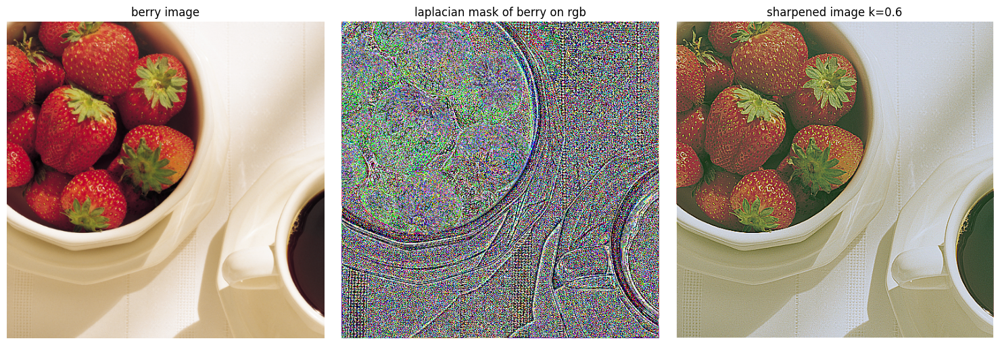

In [88]:
#Generate output for Task 3 here
berry_rgb,berry_hsv = load_image('berry.tif')


sharpval=.6
mask_berry = laplacian(berry_rgb)
sharp_berry = sharpen(berry_rgb,sharpval)

sharp_berry[:,:,0] = global_histogram_equalization(sharp_berry[:,:,0])
sharp_berry[:,:,1] = global_histogram_equalization(sharp_berry[:,:,1])
sharp_berry[:,:,2] = global_histogram_equalization(sharp_berry[:,:,2])

images=[berry_rgb,mask_berry,sharp_berry]
titles=['berry image','laplacian mask of berry on rgb',f'sharpened image k={sharpval}']

display_images(images,titles)

### Laplacian mask on HSV

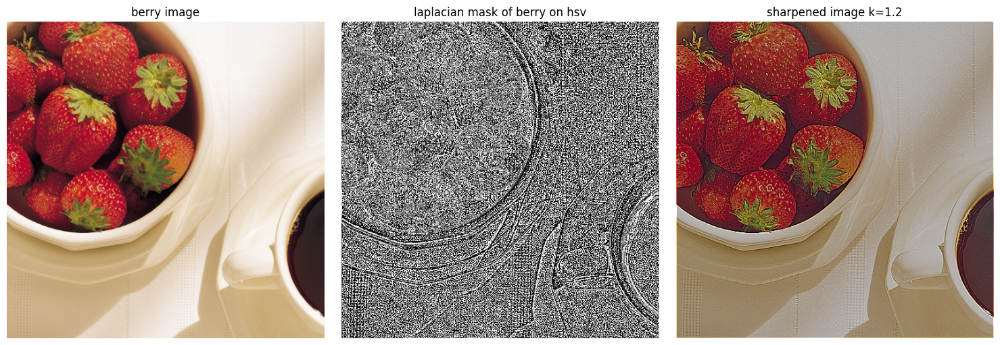

In [92]:
#Generate output for Task 3 here
berry_rgb,berry_hsv = load_image('berry.tif')

sharpvalhsv = 1.2
mask_berry = laplacian(berry_hsv,hsv=True)
sharp_berry = sharpen(berry_hsv,sharpvalhsv,hsv=True)
sharp_berry = sharp_berry.astype(np.uint8)
sharp_berry[:,:,2] = global_histogram_equalization(sharp_berry[:,:,2])

images=[berry_hsv,mask_berry,sharp_berry]
titles=['berry image','laplacian mask of berry on hsv',f'sharpened image k={sharpvalhsv}']

display_images(images,titles,conversion=cv2.COLOR_HSV2RGB)

## Analysis:
 Q.Why do we require intensity scaling after computing the sharpening?  
 Ans:  The computed laplacian mask does not guarantee that it will have its values within 0-255. The mask  has a range of negative to positive values. Negative values correspond to start of rising edges and positive values correspond to end of rising edges and vice versa. Thus after adding the edge responses, the image has to be scaled appropriately.  

 Q.How does the value of sharpen_level affect the sharpening?  
 Ans:The more the value of sharpen_level, more of the edge response is added to the image. This increases contrast between edges and the image is sharper.  

 Q.Is there any differences observed between the results of RGB and HSV color spaces?  
 Ans:  
 * RGB: The rgb laplacian mask is colorful because the kernel is convolved with 3 channels resulting in 3 edge responses for R,G,B and they are shown together as a color image.
 * HSI: The his edge response is in the intensity channel only thus it has no color in it.  

N.B. The images become sharp, but due to scaling , the range of colorful pixels are squished, thus the contrast is lowered.

# Task 4

For this task, you are required to design a function that takes two parameters: an image and a value $k$. The function should perform Unsharp masking ($k=1$) and High-boost filtering ($k>1$) and return a filtered image.

In [120]:
def high_boost_filter(image, k , hsv = False):
  #implement this function

  blurred = weightedFilter(image, 3 , hsv=hsv)
  


  mask = image - blurred

  # showImage(mask)
    
  filtered_image = image +  k * mask
  if hsv:
    filtered_image[:,:,2]=scale(filtered_image[:,:,2])
    return filtered_image
  
  return scale(filtered_image)

### Highboost filter on RGB channnels

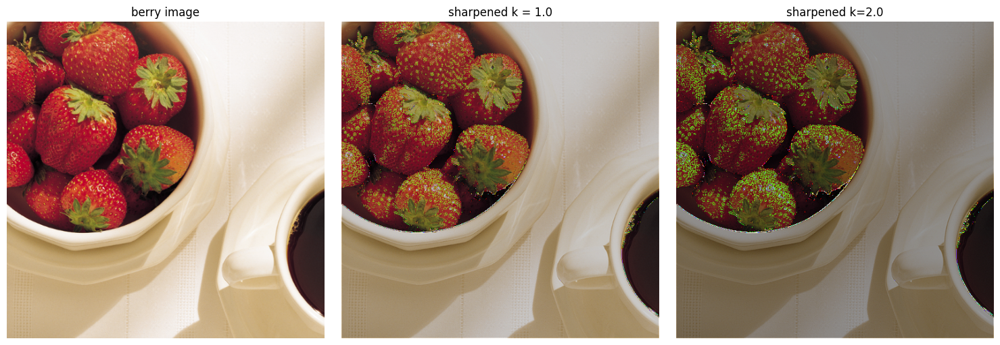

In [117]:
berry_rgb,berry_hsv = load_image('berry.tif')
 
sharp_berry = high_boost_filter (berry_rgb,1.0)
sharp_berry2 = high_boost_filter(berry_rgb,2.0)

images=[berry_rgb , sharp_berry,sharp_berry2]
titles = ['berry image','sharpened k = 1.0', 'sharpened k=2.0']

display_images(images,titles)

### Highboost filter on Intensity channel(HSV)

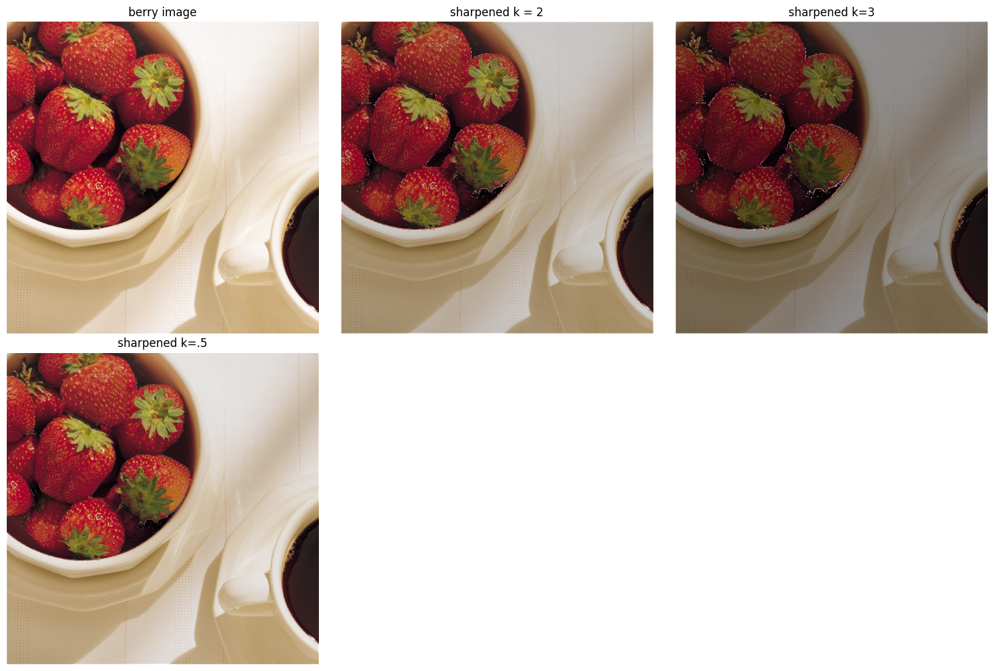

In [119]:
berry_rgb,berry_hsv = load_image('berry.tif')

sharp_berry = high_boost_filter (berry_hsv,hsv=True,k=1.0)
sharp_berry2 = high_boost_filter(berry_hsv,hsv=True,k=2.0)
sharp_berry3 = high_boost_filter(berry_hsv,hsv=True,k=0.5)

images=[berry_hsv , sharp_berry,sharp_berry2,sharp_berry3]
titles = ['berry image','sharpened k = 2', 'sharpened k=3','sharpened k=.5']

display_images(images,titles,conversion=cv2.COLOR_HSV2RGB)

# Task 4: Output and Analysis
Use your previously implemented high_boost_filter function to show the output of Unsharp Masking and High-boost filtering on an RGB image. Next, show both outputs for the HSI color space.

Provide your analysis on the following topic:

Q.Is there any difference in applying unsharp masking or high-boost filtering for RGB and HSI color space?  
Ans: 
* RGB: When the filter is applied to the rgb channels ,then the highboost filter boosts the color as well.
* HSI: When the filter is applied to the HSI color space then the highboost filter only works on the intensity channels. This does not boost the color abruply.

Q.What happens if $k<1$?  
Ans:If k<1 , there is still sharpening but it is not as visible as k>1, If k==1 then the unsharp mask is added. If k>1 then highboosting is done. If k<1 then also the edge responses from the difference of the blurred and original images are added, but with lesser intensity. The effect isnt visible when plotted using plt.
